# Problem 1

Implement the MDP using the gym Env class. The game resets once the agent finds the treasure ($r=10$). $\gamma = 0.9$. Each state has $4$ actions which moves left, right, up and down, respectively. If the agent moves against a wall, it will remain in the current state.

## environment

In [1]:
import gym
from gym import spaces
import numpy as np

class GridWorldEnv(gym.Env):
    """
    Custom Environment that follows gym interface.
    This is a simple grid world where the agent has to reach the treasure to end the episode.
    """
    metadata = {'render.modes': ['console']}
    
    def __init__(self):
        super(GridWorldEnv, self).__init__()
        
        # Define action and observation space
        # They must be gym.spaces objects
        self.action_space = spaces.Discrete(4) # Left, right, up, down
        self.observation_space = spaces.Discrete(16) # 5x5 grid world
        
        # Initial position of the agent and the treasure
        self.agent_pos = [3, 0]
        self.treasure_pos = [0, 0]
        
        # Reward for finding the treasure
        self.treasure_reward = 10
        
        # Discount factor
        self.gamma = 0.9
        
    def step(self, action):
        if self.agent_pos[0]==1 and self.agent_pos[1]!=3: #under the wall
            if action == 0: # LEFT
                self.agent_pos[1] = max(self.agent_pos[1] - 1, 0)
            elif action == 1: # RIGHT
                self.agent_pos[1] = min(self.agent_pos[1] + 1, 3)
            elif action == 2: # UP
                self.agent_pos[0] = self.agent_pos[0]
            elif action == 3: # DOWN
                self.agent_pos[0] = min(self.agent_pos[0] + 1, 3)
        elif self.agent_pos[0]==0 and self.agent_pos[1]!=3: #above the wall
            if action == 0: # LEFT
                self.agent_pos[1] = max(self.agent_pos[1] - 1, 0)
            elif action == 1: # RIGHT
                self.agent_pos[1] = min(self.agent_pos[1] + 1, 3)
            elif action == 2: # UP
                self.agent_pos[0] = max(self.agent_pos[0] - 1, 0)
            elif action == 3: # DOWN
                self.agent_pos[0] = self.agent_pos[0]
        else:
            if action == 0: # LEFT
                self.agent_pos[1] = max(self.agent_pos[1] - 1, 0)
            elif action == 1: # RIGHT
                self.agent_pos[1] = min(self.agent_pos[1] + 1, 3)
            elif action == 2: # UP
                self.agent_pos[0] = max(self.agent_pos[0] - 1, 0)
            elif action == 3: # DOWN
                self.agent_pos[0] = min(self.agent_pos[0] + 1, 3)
        
        # Calculate reward
        if self.agent_pos == self.treasure_pos:
            reward = self.treasure_reward
            done = True
        else:
            reward = 0
            done = False
            
        # Convert the agent's position to a single integer for the observation space
        obs = self.agent_pos[0] * 4 + self.agent_pos[1]
        
        return obs, reward, done, {}
    
    def reset(self):
        # Reset the agent position back to the start
        self.agent_pos = [3, 0]
        return self.agent_pos[0] * 4 + self.agent_pos[1]
    
    def render(self, mode='console'):
        if mode != 'console':
            raise NotImplementedError()
        
        # Print the grid world
        for i in range(4):
            for j in range(4):
                if i==0 and j<=2:
                    if [i, j] == self.agent_pos:
                        print('\033[1;4m' + 'A' + '\033[0m', end='\033[1;4m' + ' ' + '\033[0m')
                    elif [i, j] == self.treasure_pos:
                        print('\033[1;4m' + 'T' + '\033[0m', end='\033[1;4m' + ' ' + '\033[0m')
                    else:
                        print('\033[1;4m' + '.' + '\033[0m', end='\033[1;4m' + ' ' + '\033[0m')
                else:
                    if [i, j] == self.agent_pos:
                        print('A', end=' ')
                    elif [i, j] == self.treasure_pos:
                        print('T', end=' ')
                    else:
                        print('.', end=' ')
            print()

    

# Usage example:
env = GridWorldEnv()
obs = env.reset()
env.render()


T . . . 
. . . . 
. . . . 
A . . . 


In [2]:
env = GridWorldEnv()

# Reset the environment and render
obs = env.reset()
env.render()

# Test the environment with some actions
actions = [2, 2, 2, 2] # right, right, up, up
for action in actions:
    obs, reward, done, info = env.step(action)
    print(f"Action: {action}, New Observation: {obs}, Reward: {reward}, Done: {done}")
    env.render()
    if done:
        break

# Reset the environment to start a new episode
#env.reset()

T . . . 
. . . . 
. . . . 
A . . . 
Action: 2, New Observation: 8, Reward: 0, Done: False
T . . . 
. . . . 
A . . . 
. . . . 
Action: 2, New Observation: 4, Reward: 0, Done: False
T . . . 
A . . . 
. . . . 
. . . . 
Action: 2, New Observation: 4, Reward: 0, Done: False
T . . . 
A . . . 
. . . . 
. . . . 
Action: 2, New Observation: 4, Reward: 0, Done: False
T . . . 
A . . . 
. . . . 
. . . . 


## MDP

In [57]:
import numpy as np

def run_value_iteration(env, gamma=0.9, threshold=0.0001):
    """
    运行值迭代算法以找到最优策略。

    参数:
    - env: 环境对象。
    - gamma: 折扣因子。
    - threshold: 价值变化的阈值，用于判断迭代是否结束。

    返回:
    - policy: 每个状态下的最优动作。
    - value_table: 最终的状态价值表。
    """
    # 初始化状态价值表
    value_table = np.zeros(env.observation_space.n)
    # 迭代标志
    policy = np.zeros(env.observation_space.n)

    while True:
        updated_value_table = value_table.copy()

        # 对每个状态执行更新
        for state in range(env.observation_space.n):
            Q_value = []
            # 对每个动作计算Q值（动作价值）
            for action in range(env.action_space.n):
                next_state_reward = []
                # 在这个环境中，每个动作都是确定性的，所以我们可以直接计算下一个状态和奖励
                env.reset()
                env.agent_pos = [state // 4, state % 4]  # 将线性状态转换为二维位置
                next_state, reward, done, _ = env.step(action)
                # 计算Q值
                next_state_value = reward + gamma * updated_value_table[next_state]
                Q_value.append(next_state_value)
            
            # 选择最大的Q值更新状态价值
            value_table[state] = max(Q_value)
            # 更新策略
            policy[state] = np.argmax(Q_value)

        # 检查是否收敛
        if np.max(np.abs(updated_value_table - value_table)) < threshold:
            break
    
    return policy, value_table

# 实例化环境并运行值迭代
env = GridWorldEnv()
optimal_policy, value_table = run_value_iteration(env)

print("Action 0: Left")
print("Action 1: Right")
print("Action 2: Up")
print("Action 3: Down")
print()
print("Optimal Policy:")
for i in range(4):
    for j in range (4):
        print(optimal_policy[i*4+j],end=' ')
    print()
print()
print("Value Table:")
for i in range(4):
    for j in range (4):
        print(value_table[i*4+j],end=' ')
    print()
print()

# 演示最优策略
def demo_optimal_policy(env, policy):
    obs = env.reset()
    env.render()
    step_idx = 0
    while True:
        action = int(policy[obs])
        obs, reward, done, _ = env.step(action)
        print(f"\nStep: {step_idx} Action: {action}")
        env.render()
        if done:
            break
        step_idx += 1

# 演示
demo_optimal_policy(env, optimal_policy)


Action 0: Left
Action 1: Right
Action 2: Up
Action 3: Down

Optimal Policy:
0.0 0.0 0.0 0.0 
1.0 1.0 1.0 2.0 
1.0 1.0 1.0 2.0 
1.0 1.0 1.0 2.0 

Value Table:
99.99916647515822 99.99916647515822 89.99916647515822 80.99916647515822 
53.14326647515823 59.04816647515821 65.60916647515822 72.89916647515821 
47.828856475158226 53.14326647515823 59.04816647515821 65.60916647515822 
43.04588747515822 47.828856475158226 53.14326647515823 59.04816647515821 

T . . . 
. . . . 
. . . . 
A . . . 

Step: 0 Action: 1
T . . . 
. . . . 
. . . . 
. A . . 

Step: 1 Action: 1
T . . . 
. . . . 
. . . . 
. . A . 

Step: 2 Action: 1
T . . . 
. . . . 
. . . . 
. . . A 

Step: 3 Action: 2
T . . . 
. . . . 
. . . A 
. . . . 

Step: 4 Action: 2
T . . . 
. . . A 
. . . . 
. . . . 

Step: 5 Action: 2
T . . A 
. . . . 
. . . . 
. . . . 

Step: 6 Action: 0
T . A . 
. . . . 
. . . . 
. . . . 

Step: 7 Action: 0
T A . . 
. . . . 
. . . . 
. . . . 

Step: 8 Action: 0
A . . . 
. . . . 
. . . . 
. . . . 


# Problem 2

Implement the DQN algorithm (with experience replay and target network) with $\epsilon$-greedy exploration, i.e. the agent use the action $a_t = {argmax}_a Q_t(s_t)$ with probability $1-\epsilon$ and $a_t = \text{Unif}(A)$ with probability $\epsilon$. You are free to tune $\epsilon$ as well as other hyper-parameters in DQN as you wish. Use a two-layer MLP for the Q-network. 

- Plot the learning curve averaging over 10 runs. The learning curve measures the performance of the policy $J(\pi_t)$ as a function of episode index $t$.
- Implement double DQN, and plot its learning curve in the same graph as above.

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from collections import deque
import random

class DQN(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(DQN, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.ReLU(),
            nn.Linear(128, output_dim)
        )
    
    def forward(self, x):
        return self.net(x)

class DQNAgent:
    def __init__(self, state_dim, action_dim, learning_rate=1e-3, gamma=0.99, epsilon=1.0, epsilon_min=0.01, epsilon_decay=0.995):
        self.state_dim = state_dim
        self.action_dim = action_dim
        self.memory = deque(maxlen=10000)
        self.gamma = gamma
        self.epsilon = epsilon
        self.epsilon_min = epsilon_min
        self.epsilon_decay = epsilon_decay
        self.model = DQN(state_dim, action_dim)
        self.optimizer = optim.Adam(self.model.parameters(), lr=learning_rate)
    
    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))
    
    def act(self, state):
        if random.random() <= self.epsilon:
            return random.randrange(self.action_dim)
        state = torch.FloatTensor(state).unsqueeze(0)
        q_values = self.model(state)
        return np.argmax(q_values.detach().numpy())
    
    def replay(self, batch_size):
        if len(self.memory) < batch_size:
            return
        minibatch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in minibatch:
            state = torch.FloatTensor(state).unsqueeze(0)
            next_state = torch.FloatTensor(next_state).unsqueeze(0)
            target = reward + (1 - done) * self.gamma * torch.max(self.model(next_state))
            current_q = self.model(state).squeeze(0)[action]
            loss = (current_q - target).pow(2).mean()
            
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()
        
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

def preprocess_state(state):
    # Since your state is a single integer, we directly use it.
    # For a more complex environment, consider scaling or one-hot encoding.
    return np.array([state], dtype=np.float32)


In [67]:
# Initialize environment
env = GridWorldEnv()

state_dim = 1  # Adjusted for the single integer state representation
action_dim = env.action_space.n

agent = DQNAgent(state_dim, action_dim)
episodes = 30
batch_size = 32

for e in range(episodes):
    state = preprocess_state(env.reset())
    for time in range(500):  # Increase or decrease based on the environment complexity
        print(state)
        action = agent.act(state)
        print(action)
        next_state, reward, done, _ = env.step(action)
        next_state = preprocess_state(next_state)
        agent.remember(state, action, reward, next_state, done)
        state = next_state
        if done:
            print(f"Episode: {e+1}/{episodes}, Score: {time+1}, Epsilon: {agent.epsilon:.2}")
            break
        if len(agent.memory) > batch_size:
            agent.replay(batch_size)

[12.]
2
[8.]
1
[9.]
2
[5.]
1
[6.]
1
[7.]
0
[6.]
2
[6.]
2
[6.]
1
[7.]
0
[6.]
0
[5.]
3
[9.]
3
[13.]
3
[13.]
3
[13.]
3
[13.]
0
[12.]
2
[8.]
3
[12.]
0
[12.]
3
[12.]
2
[8.]
3
[12.]
2
[8.]
2
[4.]
1
[5.]
3
[9.]
2
[5.]
0
[4.]
3
[8.]
0
[8.]
3
[12.]
3
[12.]
2
[8.]
2
[4.]
1
[5.]
2
[5.]
3
[9.]
1
[10.]
2
[6.]
1
[7.]
2
[3.]
0
[2.]
1
[3.]
1
[3.]
2
[3.]
1
[3.]
3
[7.]
2
[3.]
1
[3.]
1
[3.]
1
[3.]
1
[3.]
0
[2.]
1
[3.]
2
[3.]
3
[7.]
2
[3.]
2
[3.]
3
[7.]
2
[3.]
3
[7.]
0
[6.]
0
[5.]
3
[9.]
3
[13.]
0
[12.]
1
[13.]
3
[13.]
2
[9.]
0
[8.]
1
[9.]
3
[13.]
3
[13.]
3
[13.]
3
[13.]
0
[12.]
2
[8.]
0
[8.]
2
[4.]
1
[5.]
2
[5.]
1
[6.]
0
[5.]
3
[9.]
2
[5.]
0
[4.]
3
[8.]
1
[9.]
1
[10.]
1
[11.]
2
[7.]
0
[6.]
1
[7.]
2
[3.]
2
[3.]
2
[3.]
2
[3.]
3
[7.]
0
[6.]
0
[5.]
2
[5.]
1
[6.]
0
[5.]
3
[9.]
3
[13.]
2
[9.]
3
[13.]
0
[12.]
2
[8.]
1
[9.]
2
[5.]
3
[9.]
1
[10.]
0
[9.]
2
[5.]
3
[9.]
1
[10.]
0
[9.]
2
[5.]
1
[6.]
3
[10.]
1
[11.]
1
[11.]
0
[10.]
1
[11.]
2
[7.]
0
[6.]
2
[6.]
0
[5.]
2
[5.]
2
[5.]
0
[4.]
2
[4.]
3
[8.]
2
[4.]
0
[4.]
1


In [63]:
def extract_optimal_policy(agent, num_states=16):
    policy = np.zeros(num_states)
    for state in range(num_states):
        state_input = preprocess_state(state)  # Make sure this matches your preprocessing
        q_values = agent.model(torch.FloatTensor(state_input).unsqueeze(0))
        policy[state] = torch.argmax(q_values).item()
    return policy


In [64]:
def demo_optimal_policy(env, policy):
    obs = env.reset()
    env.render()
    step_idx = 0
    while True:
        action = int(policy[obs])
        obs, reward, done, _ = env.step(action)
        print(f"\nStep: {step_idx} Action: {action}")
        env.render()
        if done:
            break
        step_idx += 1


In [65]:
# After training
optimal_policy = extract_optimal_policy(agent)

# Run the demonstration
demo_optimal_policy(env, optimal_policy)


T . . . 
. . . . 
. . . . 
A . . . 

Step: 0 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 1 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 2 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 3 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 4 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 5 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 6 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 7 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 8 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 9 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 10 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 14 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 15 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 16 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 17 Action: 0
T 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



. . 
. . . . 
A . . . 

Step: 11292047 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292048 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292049 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292050 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292051 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292052 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292053 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292054 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292055 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292056 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292057 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292058 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292059 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292060 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292061 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11292062 Action: 0
T . . . 
. . . . 
. .

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 
. . . . 
. . . . 
A . . . 

Step: 11935774 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935775 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935776 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935777 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935778 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935779 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935780 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935781 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935782 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935783 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935784 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935785 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935786 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935787 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935788 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 11935789 Action: 0
T . . . 
. . . 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 . . . 
A . . . 

Step: 12913891 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913892 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913893 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913894 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913895 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913896 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913897 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913898 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913899 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913900 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913901 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913902 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913903 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913904 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913905 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 12913906 Action: 0
T . . . 
. . . . 
. . . . 


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177960 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177961 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177962 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177963 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177964 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177965 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177966 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177967 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177968 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177969 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177970 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177971 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177972 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177973 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177974 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 13177975 Action: 0
T . . .

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



. . 
A . . . 

Step: 19360739 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360740 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360741 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360742 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360743 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360744 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360745 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360746 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360747 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360748 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360749 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360750 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360751 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360752 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360753 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 19360754 Action: 0
T . . . 
. . . . 
. . . . 
A .

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 . . 
. . . . 
. . . . 
A . . . 

Step: 23168208 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168209 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168210 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168211 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168212 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168213 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168214 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168215 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168216 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168217 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168218 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168219 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168220 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168221 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168222 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 23168223 Action: 0
T . . . 
. 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



 . . 
. . . . 
A . . . 

Step: 26062033 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062034 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062035 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062036 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062037 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062038 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062039 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062040 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062041 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062042 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062043 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062044 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062045 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062046 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062047 Action: 0
T . . . 
. . . . 
. . . . 
A . . . 

Step: 26062048 Action: 0
T . . . 
. . . . 
. 

KeyboardInterrupt: 

In [45]:
total_rewards = []
for e in range(episodes):
    state = preprocess_state(env.reset())
    total_episode_reward = 0  # Initialize the total reward for the episode
    
    for time in range(500):
        action = agent.act(state)
        next_state, reward, done, _ = env.step(action)
        next_state = preprocess_state(next_state)
        agent.remember(state, action, reward, next_state, done)
        
        total_episode_reward += reward  # Accumulate rewards
        
        state = next_state
        if done:
            print(f"Episode: {e+1}/{episodes}, Score: {time+1}, Epsilon: {agent.epsilon:.2}")
            total_rewards.append(total_episode_reward)  # Store the total reward
            break
        if len(agent.memory) > batch_size:
            agent.replay(batch_size)


Episode: 2/50, Score: 166, Epsilon: 0.01
Episode: 3/50, Score: 222, Epsilon: 0.01
Episode: 4/50, Score: 117, Epsilon: 0.01
Episode: 5/50, Score: 345, Epsilon: 0.01
Episode: 8/50, Score: 80, Epsilon: 0.01
Episode: 9/50, Score: 488, Epsilon: 0.01
Episode: 10/50, Score: 112, Epsilon: 0.01
Episode: 11/50, Score: 104, Epsilon: 0.01
Episode: 13/50, Score: 42, Epsilon: 0.01
Episode: 17/50, Score: 60, Epsilon: 0.01
Episode: 18/50, Score: 195, Epsilon: 0.01
Episode: 20/50, Score: 52, Epsilon: 0.01
Episode: 21/50, Score: 26, Epsilon: 0.01
Episode: 22/50, Score: 51, Epsilon: 0.01
Episode: 23/50, Score: 15, Epsilon: 0.01
Episode: 24/50, Score: 84, Epsilon: 0.01
Episode: 25/50, Score: 50, Epsilon: 0.01
Episode: 26/50, Score: 15, Epsilon: 0.01
Episode: 27/50, Score: 13, Epsilon: 0.01
Episode: 28/50, Score: 28, Epsilon: 0.01
Episode: 29/50, Score: 48, Epsilon: 0.01
Episode: 30/50, Score: 25, Epsilon: 0.01
Episode: 31/50, Score: 11, Epsilon: 0.01
Episode: 32/50, Score: 22, Epsilon: 0.01
Episode: 33/50

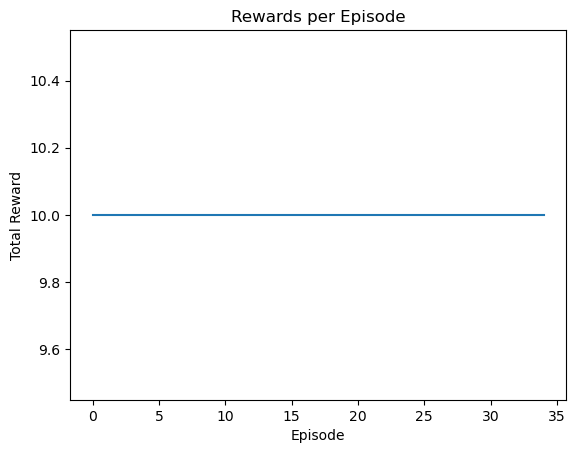

In [46]:
import matplotlib.pyplot as plt

plt.plot(total_rewards)
plt.title('Rewards per Episode')
plt.xlabel('Episode')
plt.ylabel('Total Reward')
plt.show()


In [53]:
runs = 10
episodes = 10 #50?
all_runs_rewards = np.zeros((runs, episodes))


In [54]:
for run in range(runs):
    agent = DQNAgent(state_dim, action_dim)  # Reinitialize the agent for each run
    for e in range(episodes):
        state = preprocess_state(env.reset())
        total_episode_reward = 0
        
        for time in range(500):
            action = agent.act(state)
            next_state, reward, done, _ = env.step(action)
            next_state = preprocess_state(next_state)
            agent.remember(state, action, reward, next_state, done)
            
            total_episode_reward += reward
            
            state = next_state
            if done or time == 499:
                all_runs_rewards[run, e] = total_episode_reward
                break
            if len(agent.memory) > batch_size:
                agent.replay(batch_size)


In [55]:
average_rewards = np.mean(all_runs_rewards, axis=0)


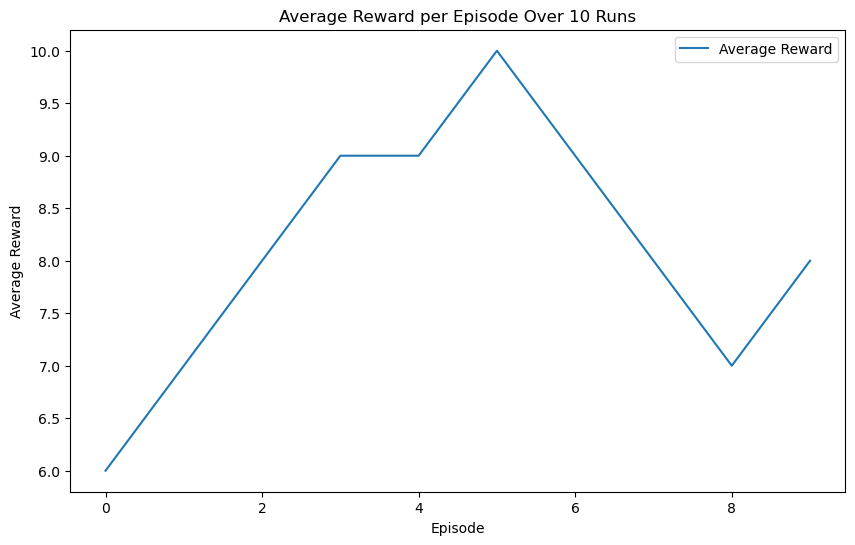

In [56]:
plt.figure(figsize=(10, 6))
plt.plot(average_rewards, label='Average Reward')
plt.title('Average Reward per Episode Over 10 Runs')
plt.xlabel('Episode')
plt.ylabel('Average Reward')
plt.legend()
plt.show()
